In [ ]:
!pip install movingpandas geopandas hvplot holoviews mapclassify --quiet

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 82.3/82.3 kB 3.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 180.6/180.6 kB 10.1 MB/s eta 0:00:00


In [ ]:
%matplotlib inline

import urllib
import os
import numpy as np
import pandas as pd
from geopandas import GeoDataFrame, read_file
from shapely.geometry import Point, LineString, Polygon
from fiona.crs import from_epsg
from datetime import datetime, timedelta
import matplotlib.pyplot as plt

import sys
sys.path.append("..")
import movingpandas as mpd
import geopandas as gpd



import hvplot.pandas
from holoviews import opts
opts.defaults(opts.Overlay(active_tools=['wheel_zoom']))



import xarray as xr
from scipy.interpolate import LSQUnivariateSpline, UnivariateSpline

import warnings
warnings.simplefilter("ignore")
CRS_METRIC = from_epsg(4326)

/usr/local/lib/python3.12/dist-packages/movingpandas/__init__.py:41: UserWarning: Missing optional dependencies. To use the trajectory smoother classes please install Stone Soup (see https://stonesoup.readthedocs.io/en/latest/#installation).
  warnings.warn(e.msg, UserWarning)


In [ ]:
from google.colab import drive

print("Mounting Google Drive...")
drive.mount('/content/drive')


Mounting Google Drive...
Mounted at /content/drive


In [ ]:
file_path = "/content/drive/MyDrive/AIS_Project/AIS_2024_Tanker_Corridor_Master.csv"

df = pd.read_csv(file_path)
len(df)

4576612

In [ ]:
df.head()

,MMSI,BaseDateTime,LAT,LON,SOG,COG,Heading,IMO,Status,Length,Width,Draft,Cargo
0,636018568,2024-01-01 00:00:04,29.27798,-94.59552,10.5,140.7,143.0,IMO9840879,0.0,230.0,32.0,11.8,80.0
1,636012629,2024-01-01 00:00:00,27.81085,-97.24973,11.4,269.0,269.0,IMO9301744,0.0,229.0,32.0,7.5,80.0
2,338617000,2024-01-01 00:00:03,27.59489,-82.95020,10.7,82.8,83.0,IMO9486958,0.0,182.0,32.0,10.3,80.0
3,538009781,2024-01-01 00:00:07,29.95980,-90.23132,9.0,316.0,316.0,IMO9292345,0.0,180.0,32.0,12.0,89.0
4,354269000,2024-01-01 00:00:03,37.31027,-123.10367,11.8,10.0,15.0,IMO9278727,0.0,160.0,27.0,6.7,82.0


In [ ]:
df.describe()

,MMSI,LAT,LON,SOG,COG,Heading,Status,Length,Width,Draft,Cargo
count,4.576612e+06,4.576612e+06,4.576612e+06,4.576612e+06,4.576612e+06,4.576612e+06,4.576612e+06,4.576612e+06,4.576612e+06,4.576612e+06,4.576612e+06
mean,4.396487e+08,3.066438e+01,-9.491479e+01,4.213432e+00,1.893573e+02,1.752660e+02,1.690418e+00,2.065693e+02,3.458660e+01,9.409048e+00,8.146702e+01
std,1.441077e+08,6.292799e+00,1.616329e+01,5.804560e+00,1.010383e+02,1.021383e+02,2.120466e+00,5.289298e+01,9.714875e+00,2.491396e+00,3.044805e+00
min,2.050970e+08,9.236110e+00,-1.756607e+02,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,3.300000e+01,4.000000e+00,1.000000e+00,8.000000e+01
25%,3.110011e+08,2.782735e+01,-9.636426e+01,0.000000e+00,1.118000e+02,9.100000e+01,0.000000e+00,1.800000e+02,2.800000e+01,8.000000e+00,8.000000e+01
50%,4.771595e+08,2.936003e+01,-9.445184e+01,1.000000e-01,1.863000e+02,1.650000e+02,1.000000e+00,1.830000e+02,3.200000e+01,9.000000e+00,8.000000e+01
75%,5.630367e+08,3.233724e+01,-8.783415e+01,1.070000e+01,2.775000e+02,2.650000e+02,5.000000e+00,2.440000e+02,4.200000e+01,1.100000e+01,8.100000e+01
max,7.750940e+08,5.222548e+01,-6.000038e+01,4.000000e+01,3.600000e+02,5.110000e+02,1.500000e+01,3.400000e+02,6.000000e+01,2.550000e+01,8.900000e+01


In [ ]:
df.isnull().sum()

,0
MMSI,0
BaseDateTime,0
LAT,0
LON,0
SOG,0
COG,0
Heading,0
IMO,3292
Status,0
Length,0


In [ ]:
df_copy=df.copy()
len(df_copy)

4576612

In [ ]:
df_copy.columns

Index(['MMSI', 'BaseDateTime', 'LAT', 'LON', 'SOG', 'COG', 'Heading', 'IMO',
       'Status', 'Length', 'Width', 'Draft', 'Cargo'],
      dtype='object')


The dataset contains **13 columns** .

**A. Identifiers**
* **`MMSI`**: *Maritime Mobile Service Identity.* A unique 9-digit radio ID. We use this to track individual vessels over time.
* **`IMO`**: *International Maritime Organization Number.* A permanent 7-digit ID that stays with the hull regardless of owner/flag changes.
* **`VesselName`**: The ship's name (e.g., "KRISTEN SPIRIT"). Often contains typos; used for validation only.
* **`CallSign`**: Radio call sign (e.g., "WDF456"). Used for voice comms; largely irrelevant for traffic modeling.

**B. Navigation & Dynamics**
* **`BaseDateTime`**: The UTC timestamp of the signal. This is the primary time axis for our time-series analysis.
* **`LAT` / `LON`**: *Latitude/Longitude.* The ship's GPS position. Used to map traffic corridors and calculate congestion density.
* **`SOG`**: *Speed Over Ground.* The actual GPS speed (knots). **Target Variable:** This is what our model will try to predict.
* **`COG`**: *Course Over Ground.* The direction of movement (0-360°).
* **`Heading`**: The direction the ship's nose is pointing. Difference between COG and Heading indicates drift (weather impact).
* **`Status`**: Navigational status (0=Underway, 1=Anchored, 5=Moored). We filter for **Status 0** to model active traffic.

**C. Vessel Specifications**
* **`VesselType`**: Numeric code for ship class. We filter for **Tankers (80–89)** relevant to CCS transport.
* **`Length` / `Width`**: Ship dimensions in meters. Critical for calculating the "traffic footprint" (space occupied per ship).
* **`Draft`**: Depth of the ship below waterline. Indicates load status (High draft = Full cargo; Low draft = Ballast/Empty).

In [ ]:
df_copy['MMSI'].value_counts()

,count
MMSI,
367353660,8734
367740790,8636
367362010,8618
538007465,8603
367635000,8597
...,...
311057300,1
352581000,1
357798000,1


In [ ]:
print(df_copy['MMSI'].value_counts().to_string())

Few ships are having only 1 row of data. These are of no use to us. Let's inspect this

In [ ]:
mmsi_counts = df_copy['MMSI'].value_counts()
mmsis = mmsi_counts[mmsi_counts == 1].index

check = df_copy[df_copy['MMSI'].isin(mmsis)][['MMSI', 'IMO', 'Length', 'Draft', 'SOG']]

# Show the first 20
check.head(20)

,MMSI,IMO,Length,Draft,SOG
1049626,357798000,IMO9180152,334.0,12.0,0.2
1051354,671268100,IMO9503574,250.0,8.2,0.0
1292403,319706000,IMO1002093,42.0,1.3,0.0
1754723,369912000,IMO8993227,57.0,3.4,2.0
2135968,368173000,IMO9681297,118.0,4.0,0.1
2482301,352581000,IMO9427500,85.0,5.7,0.6
2504924,311057300,IMO9600970,229.0,9.6,12.5
3048708,636014430,IMO9382188,102.0,5.5,0.0
3072969,368082340,IMO9841112,53.0,4.0,0.0
3783791,352001232,IMO9233650,332.0,11.0,0.3


Dropping all rows where ship is having <=50 rows of data

In [ ]:
mmsi_counts = df_copy['MMSI'].value_counts()
ghost_mmsis = mmsi_counts[mmsi_counts <= 50].index

under_50_info = df_copy[df_copy['MMSI'].isin(ghost_mmsis)][['MMSI', 'IMO', 'Length', 'Width', 'Draft', 'SOG']].drop_duplicates(subset=['MMSI'])

# Show the results
from google.colab import data_table
data_table.enable_dataframe_formatter()

print(f"Total unique ships with <= 50 pings: {len(under_50_info)}")
under_50_info

Total unique ships with <= 50 pings: 171


,MMSI,IMO,Length,Width,Draft,SOG
137,538010955,IMO9547506,179.0,32.0,12.2,0.0
248,563674000,IMO9674775,157.0,25.0,10.7,0.0
329,538005300,IMO9471329,229.0,32.0,11.4,0.0
346,319091700,IMO9374521,170.0,27.0,11.5,13.7
396,636093111,IMO9350850,183.0,32.0,8.3,0.0
...,...,...,...,...,...,...
4527922,255915915,IMO9785720,244.0,43.0,8.7,13.5
4553728,477885200,IMO9931173,183.0,32.0,10.8,12.3
4554209,241845000,IMO9946702,250.0,44.0,9.0,11.6
4558374,241622000,IMO9828338,332.0,60.0,11.1,9.4


In [ ]:
len(under_50_info)

171

In [ ]:
#  list of MMSIs that have more than 50 pings
mmsi_counts = df_copy['MMSI'].value_counts()
high_than_mmsis = mmsi_counts[mmsi_counts > 50].index

#Filter the dataframe
df_final = df_copy[df_copy['MMSI'].isin(high_than_mmsis)].copy()

# Remove the '511' Heading errors
df_final = df_final[df_final['Heading'] <= 360]

removed_rows = len(df_copy) - len(df_final)
print(f"CLEANUP COMPLETE: Removed {removed_rows} rows of noise.")
print(f"Remaining Data: {len(df_final)} rows.")
print(f"Total Unique Ships for Analysis: {df_final['MMSI'].nunique()}")

CLEANUP COMPLETE: Removed 18056 rows of noise.
Remaining Data: 4558556 rows.
Total Unique Ships for Analysis: 3589


In [ ]:
count_outliers = (df_copy['Heading'] > 360).sum()
print(f"Actual number of broken sensors: {count_outliers}")

Actual number of broken sensors: 14489


In [ ]:
print(broken_sensors['MMSI'].value_counts().to_string())

MMSI
345140400    3870
366082000    3039
312491000     870
357644000     478
477547200     477
367219000     420
353600000     408
636022805     387
345030096     342
636020224     292
368009250     189
229796000     163
323152000     137
323147000     132
316003880     131
312283000     129
518100405     119
419667000     114
241510000     114
538010511     113
345030087     109
312785000     108
538010417     102
258913000     100
257695000      84
371946000      81
477142400      75
352986205      71
312882000      71
311000915      59
354468000      55
257780000      48
351322000      47
257901000      44
636023613      43
229079000      43
369914054      37
311000279      32
636017828      31
369914055      29
368108000      28
316051091      28
538007134      27
563868000      26
355049000      26
636016596      25
538009548      20
367342960      19
312794000      19
323142000      19
316013209      18
636018722      16
249255000      16
256419000      15
538007465      14
36710

In [ ]:
df_final['MMSI'].value_counts()

,count
MMSI,
367353660,8728
367740790,8636
367362010,8617
367635000,8597
538007465,8589
...,...
374430000,52
323147000,47
613617200,45


NEARLY 3600 SHIPS


In [ ]:
df_final.describe()

,MMSI,LAT,LON,SOG,COG,Heading,Status,Length,Width,Draft,Cargo
count,4.558556e+06,4.558556e+06,4.558556e+06,4.558556e+06,4.558556e+06,4.558556e+06,4.558556e+06,4.558556e+06,4.558556e+06,4.558556e+06,4.558556e+06
mean,4.398320e+08,3.066716e+01,-9.489502e+01,4.219726e+00,1.892161e+02,1.742118e+02,1.692204e+00,2.067339e+02,3.461339e+01,9.417358e+00,8.146842e+01
std,1.441919e+08,6.275320e+00,1.613119e+01,5.807855e+00,1.009339e+02,1.005262e+02,2.121318e+00,5.274980e+01,9.693637e+00,2.484632e+00,3.046208e+00
min,2.050970e+08,9.236110e+00,-1.756607e+02,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,3.300000e+01,4.000000e+00,1.000000e+00,8.000000e+01
25%,3.110010e+08,2.782902e+01,-9.633995e+01,0.000000e+00,1.117000e+02,9.100000e+01,0.000000e+00,1.800000e+02,2.800000e+01,8.000000e+00,8.000000e+01
50%,4.771858e+08,2.936001e+01,-9.445091e+01,1.000000e-01,1.861000e+02,1.640000e+02,1.000000e+00,1.830000e+02,3.200000e+01,9.000000e+00,8.000000e+01
75%,5.630416e+08,3.233685e+01,-8.790551e+01,1.070000e+01,2.772000e+02,2.640000e+02,5.000000e+00,2.440000e+02,4.200000e+01,1.100000e+01,8.100000e+01
max,7.102340e+08,5.222548e+01,-6.000038e+01,4.000000e+01,3.600000e+02,3.590000e+02,1.500000e+01,3.400000e+02,6.000000e+01,2.550000e+01,8.900000e+01


# VISUALISATION


In [ ]:

df_sample = df_final.sample(frac=0.2, random_state=42)

sns.set_theme(style="darkgrid", palette="muted")
fig, axes = plt.subplots(2, 2, figsize=(20, 15))

# PLOT 1
sns.scatterplot(data=df_sample, x='LON', y='LAT', hue='SOG',
                size='SOG', sizes=(1, 20), alpha=0.3, ax=axes[0, 0])
axes[0, 0].set_title('Shipping Density & Speed (Where are they moving?)')

#  PLOT 2
sns.regplot(data=df_sample[df_sample['SOG'] > 1], x='Draft', y='SOG',
            scatter_kws={'alpha':0.1, 'color':'teal'}, line_kws={'color':'red'}, ax=axes[0, 1])
axes[0, 1].set_title('Speed vs. Draft (Does weight slow them down?)')

#PLOT 3
sns.boxplot(data=df_sample, x='Status', y='SOG', ax=axes[1, 0])
axes[1, 0].set_title('Speed Distribution per AIS Status')

# PLOT 4
corr = df_final[['SOG', 'COG', 'Heading', 'Length', 'Width', 'Draft']].corr()
sns.heatmap(corr, annot=True, cmap='coolwarm', fmt=".2f", ax=axes[1, 1])
axes[1, 1].set_title('Variable Correlation (The Feature Selector)')

plt.tight_layout()
plt.show()

In [ ]:
!pip install geoviews bokeh cartopy --quiet

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 574.7/574.7 kB 14.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 7.2/7.2 MB 109.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 11.8/11.8 MB 122.1 MB/s eta 0:00:00


<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W
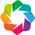

:Overlay
   .WMTS.I   :WMTS   [Longitude,Latitude]
   .Points.I :Points   [Longitude,Latitude]   (SOG,MMSI,Length)

In [ ]:
import geopandas as gpd
import holoviews as hv
import geoviews as gv
from holoviews import opts
from cartopy import crs

# Initialize Holoviews with Bokeh backend
hv.extension('bokeh')

df_map_sample = df_sample.sample(n=100000, random_state=42)

# Convert to GeoPandas
gdf = gpd.GeoDataFrame(
    df_map_sample,
    geometry=gpd.points_from_xy(df_map_sample.LON, df_map_sample.LAT),
    crs="EPSG:4326"
)

points = gv.Points(gdf, vdims=['SOG', 'MMSI', 'Length'], crs=crs.PlateCarree())

layout = gv.tile_sources.OSM * points.opts(
    opts.Points(
        color='SOG',
        cmap='viridis',
        size=3,
        alpha=0.5,
        tools=['hover'],
        width=800,
        height=600,
        colorbar=True,
        title="Interactive Fleet Map: Speed Distribution"
    )
)

layout

In [ ]:
hubs = {'Bayou Bend': (29.6000, -94.0000), 'Pelican Hub': (30.5683, -90.6825)}
search_buffer = 0.60

target_mmsis = []
for name, (lat, lon) in hubs.items():
    mask = (df_final['LAT'].between(lat - search_buffer, lat + search_buffer)) & \
           (df_final['LON'].between(lon - search_buffer, lon + search_buffer))
    visited = df_final[mask]['MMSI'].unique()
    target_mmsis.extend(visited)

# Get Top 15 ships
df_hubs_all = df_final[df_final['MMSI'].isin(list(set(target_mmsis)))]
top_15_mmsis = df_hubs_all['MMSI'].value_counts().head(15).index.tolist()
df_plot = df_hubs_all[df_hubs_all['MMSI'].isin(top_15_mmsis)].sort_values(['MMSI', 'BaseDateTime'])

# Geodataframe
gdf_plot = gpd.GeoDataFrame(df_plot, geometry=gpd.points_from_xy(df_plot.LON, df_plot.LAT), crs="EPSG:4326")
gdf_plot['MMSI_STR'] = gdf_plot['MMSI'].astype(str)

# Graph
points = gv.Points(gdf_plot, vdims=['MMSI_STR', 'SOG', 'Draft', 'BaseDateTime'], crs=crs.PlateCarree(), label='Vessels')
hub_markers = gv.Points([(h[1], h[0]) for h in hubs.values()], crs=crs.PlateCarree(), label='CCS Hub Centers')

layout = gv.tile_sources.OSM * points.opts(
    opts.Points(color='MMSI_STR', cmap='Category20', size=4, alpha=0.6,
                tools=['hover', 'wheel_zoom', 'pan'], width=900, height=600,
                title="Gulf CCS Trajectories: Top 15 Vessel Candidates")
) * hub_markers.opts(
    opts.Points(size=12, color='red', marker='triangle')
)

layout

In [ ]:
unique_fleet = list(set(target_mmsis))
total_count = len(unique_fleet)

print(f"--- FLEET CENSUS REPORT ---")
print(f"Total unique ships servicing the CCS hubs: {total_count}")
print(f"Total rows of data for this fleet: {len(df_hubs_all):,}")


--- FLEET CENSUS REPORT ---
Total unique ships servicing the CCS hubs: 2407
Total rows of data for this fleet: 3,340,912


<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W
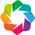

:HoloMap   [Vessel MMSI]
   :Overlay
      .WMTS.I          :WMTS   [Longitude,Latitude]
      .Points.I        :Points   [Longitude,Latitude]   (MMSI_STR,SOG,Draft,BaseDateTime)
      .Points.CCS_Hubs :Points   [lon,lat]   (name)
      .Labels.I        :Labels   [lon,lat]   (name)

In [ ]:
hub_data = pd.DataFrame([
    {'name': 'Bayou Bend', 'lat': 29.6000, 'lon': -94.0000},
    {'name': 'Pelican Hub', 'lat': 30.5683, 'lon': -90.6825}
])

hub_points = gv.Points(hub_data, kdims=['lon', 'lat'], label='CCS Hubs').opts(
    size=12, color='red', marker='triangle', line_color='black', tools=['hover']
)

hub_labels = gv.Labels(hub_data, kdims=['lon', 'lat'], vdims='name').opts(
    text_font_size='12pt', text_color='red', text_font_style='bold', xoffset=0.2
)

# Selection
def select_ship_with_hubs(mmsi_selection):
    vessel_data = gdf_plot[gdf_plot['MMSI_STR'] == mmsi_selection]

    vessel_points = gv.Points(vessel_data, vdims=['MMSI_STR', 'SOG', 'Draft', 'BaseDateTime'],
                              crs=crs.PlateCarree())

    return gv.tile_sources.OSM * vessel_points.opts(
        opts.Points(color='SOG', cmap='plasma', size=6, alpha=0.8,
                    tools=['hover'], width=850, height=600, colorbar=True)
    ) * hub_points * hub_labels

ship_list = sorted(gdf_plot['MMSI_STR'].unique())
interactive_map = hv.HoloMap({m: select_ship_with_hubs(m) for m in ship_list}, kdims='Vessel MMSI')

interactive_map

In [ ]:

# Major industrial starting points
source_data = pd.DataFrame([
    {'name': 'Houston Ship Channel', 'lat': 29.7500, 'lon': -95.1000},
    {'name': 'Port Arthur / Beaumont', 'lat': 29.8600, 'lon': -93.9300},
    {'name': 'Plaquemine (LA Corridor)', 'lat': 30.2900, 'lon': -91.2300}
])

hub_points = gv.Points(hub_data, kdims=['lon', 'lat'], label='Sequestration Hubs').opts(
    size=12, color='red', marker='triangle', line_color='black', tools=['hover']
)
hub_labels = gv.Labels(hub_data, kdims=['lon', 'lat'], vdims='name').opts(
    text_font_size='11pt', text_color='red', text_font_style='bold', xoffset=0.25
)

source_points = gv.Points(source_data, kdims=['lon', 'lat'], label='Industrial Sources').opts(
    size=10, color='dodgerblue', marker='circle', line_color='white', tools=['hover']
)
source_labels = gv.Labels(source_data, kdims=['lon', 'lat'], vdims='name').opts(
    text_font_size='10pt', text_color='dodgerblue', text_font_style='italic', xoffset=0.25
)


def select_ship_complete(mmsi_selection):
    vessel_data = gdf_plot[gdf_plot['MMSI_STR'] == mmsi_selection]

    vessel_points = gv.Points(vessel_data, vdims=['MMSI_STR', 'SOG', 'Draft', 'BaseDateTime'],
                              crs=crs.PlateCarree())

    return (gv.tile_sources.OSM * vessel_points.opts(opts.Points(color='SOG', cmap='plasma', size=6, alpha=0.8,
                                          tools=['hover'], width=900, height=650, colorbar=True,
                                          title=f"Logistics Path for MMSI: {mmsi_selection}")) * source_points * source_labels * hub_points * hub_labels)

ship_list = sorted(gdf_plot['MMSI_STR'].unique())
interactive_map = hv.HoloMap({m: select_ship_complete(m) for m in ship_list}, kdims='Vessel MMSI')

interactive_map

Filtering coordinates

In [ ]:
lon = (-162.0, -150.0)
lat = (18.0, 23.0)

pacific_mmsis = df_final[
    (df_final['LON'].between(*lon)) &
    (df_final['LAT'].between(*lat))
]['MMSI'].unique()

#From these ships, check which ones never visit the Gulf Hubs
mmsis_to_drop = [m for m in pacific_mmsis if m not in target_mmsis]

df_removedoutlierships = df_final[~df_final['MMSI'].isin(mmsis_to_drop)]

print(f"Purged {len(mmsis_to_drop)} ships that stay in the Pacific.")
print(f"Remaining unique vessels: {df_removedoutlierships['MMSI'].nunique()}")

Purged 73 ships that stay in the Pacific.
Remaining unique vessels: 3516


In [ ]:
len(df_removedoutlierships)

4477541

In [ ]:
df_removedoutlierships.describe()

,MMSI,LAT,LON,SOG,COG,Heading,Status,Length,Width,Draft,Cargo
count,4.477541e+06,4.477541e+06,4.477541e+06,4.477541e+06,4.477541e+06,4.477541e+06,4.477541e+06,4.477541e+06,4.477541e+06,4.477541e+06,4.477541e+06
mean,4.405357e+08,3.064582e+01,-9.430676e+01,4.213436e+00,1.892455e+02,1.741994e+02,1.692862e+00,2.067809e+02,3.461196e+01,9.408879e+00,8.148037e+01
std,1.444513e+08,6.171814e+00,1.525832e+01,5.806221e+00,1.009114e+02,1.005717e+02,2.121292e+00,5.278992e+01,9.707819e+00,2.479162e+00,3.055794e+00
min,2.050970e+08,9.236110e+00,-1.756607e+02,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,3.700000e+01,8.000000e+00,1.000000e+00,8.000000e+01
25%,3.110010e+08,2.783247e+01,-9.566356e+01,0.000000e+00,1.118000e+02,9.100000e+01,0.000000e+00,1.800000e+02,2.800000e+01,8.000000e+00,8.000000e+01
50%,4.773481e+08,2.935445e+01,-9.442026e+01,1.000000e-01,1.862000e+02,1.650000e+02,1.000000e+00,1.830000e+02,3.200000e+01,9.000000e+00,8.000000e+01
75%,5.630475e+08,3.227262e+01,-8.748220e+01,1.070000e+01,2.772000e+02,2.640000e+02,5.000000e+00,2.440000e+02,4.200000e+01,1.100000e+01,8.100000e+01
max,7.100333e+08,5.222548e+01,-6.000038e+01,4.000000e+01,3.600000e+02,3.590000e+02,1.500000e+01,3.400000e+02,6.000000e+01,2.550000e+01,8.900000e+01


In [ ]:
noise_lon = (-176.0, -112.0)
noise_lat = (21.0, 53.0)

outlier_mmsis = df_final[
    (df_final['LON'].between(*noise_lon)) &
    (df_final['LAT'].between(*noise_lat))
]['MMSI'].unique()

mmsis_to_permanently_drop = [m for m in outlier_mmsis if m not in target_mmsis]

df_removedoutlierships = df_removedoutlierships[~df_removedoutlierships['MMSI'].isin(mmsis_to_permanently_drop)]

print(f"Purged {len(mmsis_to_permanently_drop)} vessels that are Pacific/West Coast locals.")
print(f"Cleaned Row Count: {len(df_removedoutlierships):,}")
print(f"Unique Gulf-Connected Vessels remaining: {df_removedoutlierships['MMSI'].nunique()}")

Purged 470 vessels that are Pacific/West Coast locals.
Cleaned Row Count: 3,927,752
Unique Gulf-Connected Vessels remaining: 3118


In [ ]:
df_removedoutlierships.describe()

,MMSI,LAT,LON,SOG,COG,Heading,Status,Length,Width,Draft,Cargo
count,3.927752e+06,3.927752e+06,3.927752e+06,3.927752e+06,3.927752e+06,3.927752e+06,3.927752e+06,3.927752e+06,3.927752e+06,3.927752e+06,3.927752e+06
mean,4.412594e+08,2.974256e+01,-9.095891e+01,4.232678e+00,1.899251e+02,1.706415e+02,1.712757e+00,2.034786e+02,3.394431e+01,9.228536e+00,8.147278e+01
std,1.462728e+08,5.491027e+00,1.254644e+01,5.860802e+00,1.004406e+02,1.000667e+02,2.125521e+00,5.175263e+01,9.373668e+00,2.290578e+00,3.026261e+00
min,2.050970e+08,9.236110e+00,-1.755905e+02,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,5.200000e+01,8.000000e+00,1.000000e+00,8.000000e+01
25%,3.110007e+08,2.781402e+01,-9.502157e+01,0.000000e+00,1.130000e+02,8.900000e+01,0.000000e+00,1.800000e+02,2.800000e+01,7.800000e+00,8.000000e+01
50%,4.776928e+08,2.928202e+01,-9.388534e+01,1.000000e-01,1.880000e+02,1.590000e+02,1.000000e+00,1.830000e+02,3.200000e+01,8.800000e+00,8.000000e+01
75%,5.630873e+08,2.999354e+01,-8.246128e+01,1.080000e+01,2.768000e+02,2.590000e+02,5.000000e+00,2.370000e+02,4.200000e+01,1.080000e+01,8.100000e+01
max,7.100333e+08,5.222548e+01,-6.000038e+01,4.000000e+01,3.600000e+02,3.590000e+02,1.500000e+01,3.400000e+02,6.000000e+01,2.550000e+01,8.900000e+01


In [ ]:

noise_lon = (-176.0, -112.0)
noise_lat = (21.0, 53.0)

outlier_mmsis = df_removedoutlierships[
    (df_removedoutlierships['LON'].between(*noise_lon)) &
    (df_removedoutlierships['LAT'].between(*noise_lat))
]['MMSI'].unique()

mmsis_to_permanently_drop = [m for m in outlier_mmsis]

df_westsidecompletelyremoved = df_removedoutlierships[~df_removedoutlierships['MMSI'].isin(mmsis_to_permanently_drop)]

print(f"Purged {len(mmsis_to_permanently_drop)} vessels that are Pacific/West Coast locals.")
print(f"Cleaned Row Count: {len(df_westsidecompletelyremoved):,}")
print(f"Unique Gulf-Connected Vessels remaining: {df_westsidecompletelyremoved['MMSI'].nunique()}")

Purged 762 vessels that are Pacific/West Coast locals.
Cleaned Row Count: 2,880,188
Unique Gulf-Connected Vessels remaining: 2356


In [ ]:
# find every MMSI that has at least one ping in the Pacific noise zone
blacklist_mmsis = df_removedoutlierships[
    (df_removedoutlierships['LON'].between(-176.0, -112.0)) &
    (df_removedoutlierships['LAT'].between(21.0, 53.0))
]['MMSI'].unique()

df_westsidecompletelyremoved = df_removedoutlierships[
    ~df_removedoutlierships['MMSI'].isin(blacklist_mmsis)
].copy()

print(f"Total ships blacklisted: {len(blacklist_mmsis)}")
print(f"New Min Longitude: {df_westsidecompletelyremoved['LON'].min()}")

Total ships blacklisted: 762
New Min Longitude: -165.38627


In [ ]:
(df_westsidecompletelyremoved['LON'] < -112.0).value_counts()

,count
LON,
False,2879674
True,514


In [ ]:
df_westsidecompletelyremoved.describe()

,MMSI,LAT,LON,SOG,COG,Heading,Status,Length,Width,Draft,Cargo
count,2.880188e+06,2.880188e+06,2.880188e+06,2.880188e+06,2.880188e+06,2.880188e+06,2.880188e+06,2.880188e+06,2.880188e+06,2.880188e+06,2.880188e+06
mean,4.351222e+08,2.952559e+01,-8.787422e+01,4.066459e+00,1.886088e+02,1.665179e+02,1.744368e+00,2.046407e+02,3.430817e+01,9.186869e+00,8.156882e+01
std,1.478748e+08,5.495160e+00,9.360058e+00,5.749937e+00,1.004897e+02,9.974150e+01,2.147815e+00,5.733494e+01,1.043981e+01,2.443863e+00,3.107598e+00
min,2.052830e+08,9.236110e+00,-1.653863e+02,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,5.200000e+01,8.000000e+00,1.100000e+00,8.000000e+01
25%,3.110001e+08,2.778527e+01,-9.468097e+01,0.000000e+00,1.099000e+02,8.600000e+01,0.000000e+00,1.690000e+02,2.600000e+01,7.700000e+00,8.000000e+01
50%,4.771001e+08,2.921925e+01,-9.328120e+01,1.000000e-01,1.880000e+02,1.550000e+02,1.000000e+00,1.830000e+02,3.200000e+01,8.800000e+00,8.000000e+01
75%,5.630222e+08,2.991727e+01,-8.028973e+01,1.040000e+01,2.730000e+02,2.510000e+02,5.000000e+00,2.490000e+02,4.400000e+01,1.080000e+01,8.100000e+01
max,7.100333e+08,5.222548e+01,-6.000038e+01,4.000000e+01,3.600000e+02,3.590000e+02,1.500000e+01,3.400000e+02,6.000000e+01,2.550000e+01,8.900000e+01


In [ ]:
bad_ships = df_westsidecompletelyremoved[
    df_westsidecompletelyremoved['LON'] < -112
]['MMSI'].unique()

print(f" Found {len(bad_ships)} ships that violated the boundary.")
print(f" MMSIs: {bad_ships}")


df_completelyremovedoutliers = df_westsidecompletelyremoved[
    ~df_westsidecompletelyremoved['MMSI'].isin(bad_ships)
].copy()

if len(df_completelyremovedoutliers[df_completelyremovedoutliers['LON'] < -112]) == 0:
    print("VERIFIED: No traces of the blacklisted ships remain.")
else:
    print(" Something went wrong. Check the column name (is it MMSI?)")

In [ ]:
df_completelyremovedoutliers.describe()

,MMSI,LAT,LON,SOG,COG,Heading,Status,Length,Width,Draft,Cargo
count,2.839195e+06,2.839195e+06,2.839195e+06,2.839195e+06,2.839195e+06,2.839195e+06,2.839195e+06,2.839195e+06,2.839195e+06,2.839195e+06,2.839195e+06
mean,4.353229e+08,2.953313e+01,-8.783042e+01,4.067618e+00,1.885650e+02,1.665355e+02,1.743634e+00,2.045422e+02,3.430604e+01,9.185832e+00,8.157553e+01
std,1.478295e+08,5.512060e+00,9.349061e+00,5.745371e+00,1.004953e+02,9.978661e+01,2.148916e+00,5.750523e+01,1.048759e+01,2.452483e+00,3.117779e+00
min,2.052830e+08,1.013595e+01,-1.118263e+02,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,5.200000e+01,8.000000e+00,2.000000e+00,8.000000e+01
25%,3.110002e+08,2.778386e+01,-9.467964e+01,0.000000e+00,1.098000e+02,8.600000e+01,0.000000e+00,1.660000e+02,2.600000e+01,7.600000e+00,8.000000e+01
50%,4.771295e+08,2.921809e+01,-9.326716e+01,1.000000e-01,1.879000e+02,1.550000e+02,1.000000e+00,1.830000e+02,3.200000e+01,8.800000e+00,8.000000e+01
75%,5.630208e+08,2.992256e+01,-8.020671e+01,1.040000e+01,2.729000e+02,2.510000e+02,5.000000e+00,2.490000e+02,4.400000e+01,1.080000e+01,8.100000e+01
max,7.100333e+08,5.222548e+01,-6.000038e+01,4.000000e+01,3.600000e+02,3.590000e+02,1.500000e+01,3.400000e+02,6.000000e+01,2.540000e+01,8.900000e+01


In [ ]:
#Saving new cleaned dataset
save_path = "/content/drive/MyDrive/AIS_Project"

file_name = 'cleaned_noaa_fleet_2024_2.csv'
df_completelyremovedoutliers.to_csv(os.path.join(save_path, file_name), index=False, compression='gzip')

print(f"Dataset successfully exported to Drive: {file_name}")

Dataset successfully exported to Drive: cleaned_noaa_fleet_2024_2.csv
